In [180]:
# Import libraries
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from PIL import Image 

input_annotation_file = 'data/icc_val/results-an0.txt'
df_annotator_0 = pd.read_csv(input_annotation_file, header=None)


input_annotation_file = 'data/icc_val/results-an1.txt'
df_annotator_1 = pd.read_csv(input_annotation_file, header=None)

def qa_to_num(quality_check):
    if quality_check=='Acceptable, no changes':
        return 1
    elif quality_check=='Acceptable, minor changes':
        return 2
    elif quality_check=='Unacceptable, major changes':
        return 3
    elif quality_check=='Unacceptable, not visible/wrong location':
        return 4

df_annotator_0.rename({0: 'id_number', 1: 'ID',2:"Dataset",3:'Age',4:"Gender",5:"Raw_path",6:"Segmentation",7:"QA"}, axis=1, inplace=True)
df_annotator_1.rename({0: 'id_number', 1: 'ID',2:"Dataset",3:'Age',4:"Gender",5:"Raw_path",6:"Segmentation",7:"QA"}, axis=1, inplace=True)
df_annotator_0['annotator'] = 'id0'
df_annotator_1['annotator'] = 'id1'

def f(row):
    if row['QA'] == 1 or row['QA'] ==2:
        val = 1
    else:
        val = 0
    return val


df_annotator_0['QA_to_bin'] = df_annotator_0.apply(f, axis=1)
df_annotator_1['QA_to_bin'] = df_annotator_1.apply(f, axis=1)
df = pd.merge(df_annotator_0, df_annotator_1, on="Segmentation")

#merge dfs
res = df_annotator_0.append(df_annotator_1)
res['QA_to_bin'] = res.apply(f, axis=1)

/tmp/ipykernel_1225801/2293368861.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  res = df_annotator_0.append(df_annotator_1)


In [145]:
import pingouin as pg
icc = pg.intraclass_corr(data=res, targets='id_number', raters='annotator', ratings='QA')
icc.set_index('Type')
#https://www.statology.org/intraclass-correlation-coefficient/
# Koo & Li:

#Less than 0.50: Poor reliability
#Between 0.5 and 0.75: Moderate reliability
#Between 0.75 and 0.9: Good reliability
#Greater than 0.9: Excellent reliability


,Description,ICC,F,df1,df2,pval,CI95%
Type,,,,,,,
ICC1,Single raters absolute,0.418110,2.437075,3129,3130,4.448878e-133,"[0.39, 0.45]"
ICC2,Single random raters,0.418057,2.436317,3129,3129,5.801025e-133,"[0.39, 0.45]"
ICC3,Single fixed raters,0.417982,2.436317,3129,3129,5.801025e-133,"[0.39, 0.45]"
ICC1k,Average raters absolute,0.589672,2.437075,3129,3130,4.448878e-133,"[0.56, 0.62]"
ICC2k,Average random raters,0.589620,2.436317,3129,3129,5.801025e-133,"[0.56, 0.62]"
ICC3k,Average fixed raters,0.589544,2.436317,3129,3129,5.801025e-133,"[0.56, 0.62]"


In [146]:
from sklearn.metrics import cohen_kappa_score

#define array of ratings for both raters
rater1 = df['QA_to_bin_x']
rater2 = df['QA_to_bin_y']

#calculate Cohen's Kappa "Fair"
cohen_kappa_score(rater1, rater2)

0.31836615107950006

In [147]:
len(df[(df['QA_to_bin_x']==1) & (df['QA_to_bin_y']==1)])/len(df),len(df[(df['QA_to_bin_x']==1) & (df['QA_to_bin_y']==1)]), len(df), len(df)-len(df[(df['QA_to_bin_x']==1) & (df['QA_to_bin_y']==1)])

(0.9314171883893, 3273, 3514, 241)

In [148]:
len(df[(df['QA_to_bin_x']==0) & (df['QA_to_bin_y']==0)])/len(df),len(df[(df['QA_to_bin_x']==0) & (df['QA_to_bin_y']==0)]), len(df), len(df)-len(df[(df['QA_to_bin_x']==0) & (df['QA_to_bin_y']==0)])

(0.013944223107569721, 49, 3514, 3465)

In [149]:
len(df[(df['QA_to_bin_x']==1) & (df['QA_to_bin_y']==0)])+len(df[(df['QA_to_bin_x']==0) & (df['QA_to_bin_y']==1)])

192

In [ ]:
#,ID,Dataset,Age,Gender,Raw_path,Segmentation_1

In [153]:
df_ones = df[(df['QA_to_bin_x']==1) & (df['QA_to_bin_y']==0)]
df_twos = df[(df['QA_to_bin_x']==0) & (df['QA_to_bin_y']==1)]
df_ones = df_ones.append(df_twos)
df_ones.to_csv("dataset_double_check.csv")

/tmp/ipykernel_1225801/3681870396.py:3: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_ones = df_ones.append(df_twos)


In [157]:

df_ones.rename({"ID_x": 'ID',"Dataset_x":"Dataset","Age_x":'Age',"Gender_x":"Gender","Raw_path_x":"Raw_path"}, axis=1, inplace=True)
df_ones.to_csv("dataset_double_check.csv")
df_ones

,id_number_x,ID,Dataset,Age,Gender,Raw_path,Segmentation,QA_x,annotator_x,QA_to_bin_x,id_number_y,ID_y,Dataset_y,Age_y,Gender_y,Raw_path_y,QA_y,annotator_y,QA_to_bin_y
97,97,CL_Dev_015,Calgary,4,2,data_curation_scripts/human_validator/raw_nift...,data_curation_scripts/human_validator/pics/CL_...,2,id0,1,97,CL_Dev_015,Calgary,4,2,data_curation_scripts/human_validator/raw_nift...,3,id1,0
250,250,clamp_1114_v2_t1w,NIMH,6,2,data_curation_scripts/human_validator/raw_nift...,data_curation_scripts/human_validator/pics/cla...,2,id0,1,250,clamp_1114_v2_t1w,NIMH,6,2,data_curation_scripts/human_validator/raw_nift...,3,id1,0
767,767,sub-NDARINVPPTGWLKJ_ses-2YearFollowUpYArm1_run...,ABCD,11,2,data_curation_scripts/human_validator/raw_nift...,data_curation_scripts/human_validator/pics/sub...,1,id0,1,767,sub-NDARINVPPTGWLKJ_ses-2YearFollowUpYArm1_run...,ABCD,11,2,data_curation_scripts/human_validator/raw_nift...,3,id1,0
828,828,sub-NDARINVUM3L54UF_ses-2YearFollowUpYArm1_run...,ABCD,12,1,data_curation_scripts/human_validator/raw_nift...,data_curation_scripts/human_validator/pics/sub...,1,id0,1,828,sub-NDARINVUM3L54UF_ses-2YearFollowUpYArm1_run...,ABCD,12,1,data_curation_scripts/human_validator/raw_nift...,3,id1,0
829,829,sub-NDARINVUM3L54UF_ses-2YearFollowUpYArm1_run...,ABCD,12,1,data_curation_scripts/human_validator/raw_nift...,data_curation_scripts/human_validator/pics/sub...,1,id0,1,829,sub-NDARINVUM3L54UF_ses-2YearFollowUpYArm1_run...,ABCD,12,1,data_curation_scripts/human_validator/raw_nift...,3,id1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3454,3084,sub-ON35773_ses-01_acq-MPRAGE_T1w,Healthy adults,35,1,data_curation_scripts/human_validator/raw_nift...,data_curation_scripts/human_validator/pics/sub...,3,id0,0,3084,sub-ON35773_ses-01_acq-MPRAGE_T1w,Healthy adults,35,1,data_curation_scripts/human_validator/raw_nift...,2,id1,1
3455,3084,sub-ON35773_ses-01_acq-MPRAGE_T1w,Healthy adults,35,1,data_curation_scripts/human_validator/raw_nift...,data_curation_scripts/human_validator/pics/sub...,3,id0,0,3128,sub-ON35773_ses-01_acq-MPRAGE_T1w,Healthy adults,35,1,data_curation_scripts/human_validator/raw_nift...,2,id1,1
3456,3128,sub-ON35773_ses-01_acq-MPRAGE_T1w,Healthy adults,35,1,data_curation_scripts/human_validator/raw_nift...,data_curation_scripts/human_validator/pics/sub...,3,id0,0,3084,sub-ON35773_ses-01_acq-MPRAGE_T1w,Healthy adults,35,1,data_curation_scripts/human_validator/raw_nift...,2,id1,1
3457,3128,sub-ON35773_ses-01_acq-MPRAGE_T1w,Healthy adults,35,1,data_curation_scripts/human_validator/raw_nift...,data_curation_scripts/human_validator/pics/sub...,3,id0,0,3128,sub-ON35773_ses-01_acq-MPRAGE_T1w,Healthy adults,35,1,data_curation_scripts/human_validator/raw_nift...,2,id1,1


Anna accepted; Ben not accepted 16


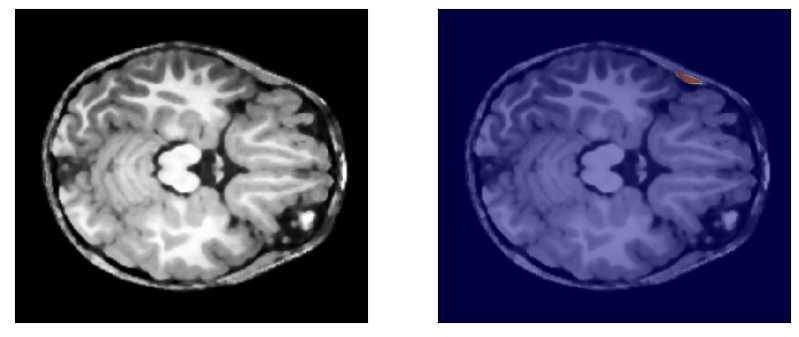

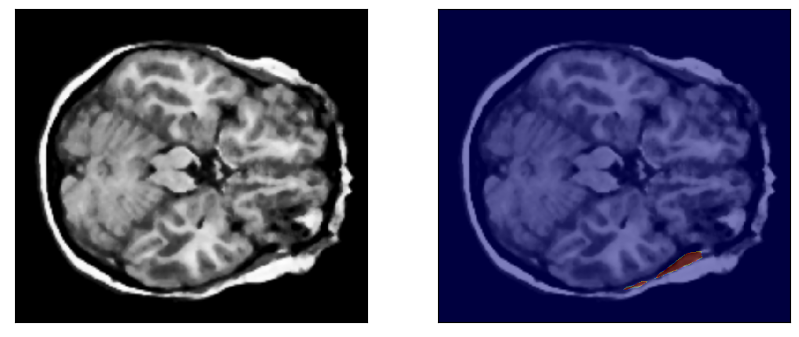

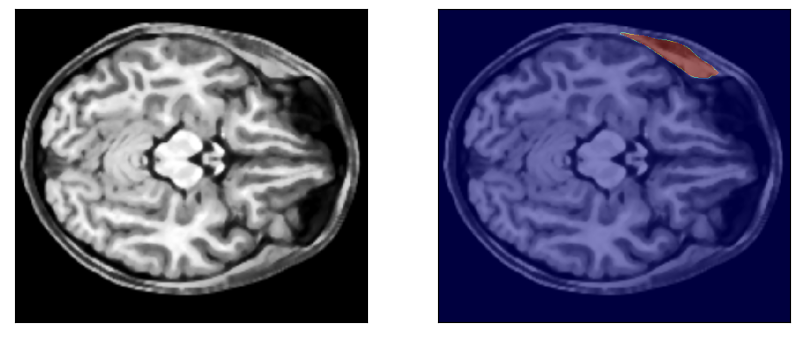

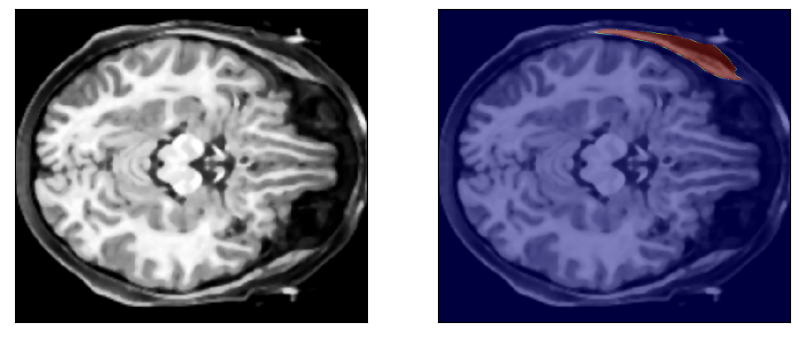

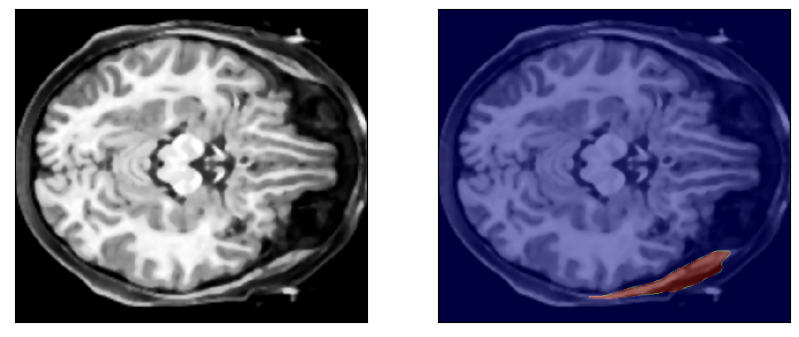

...

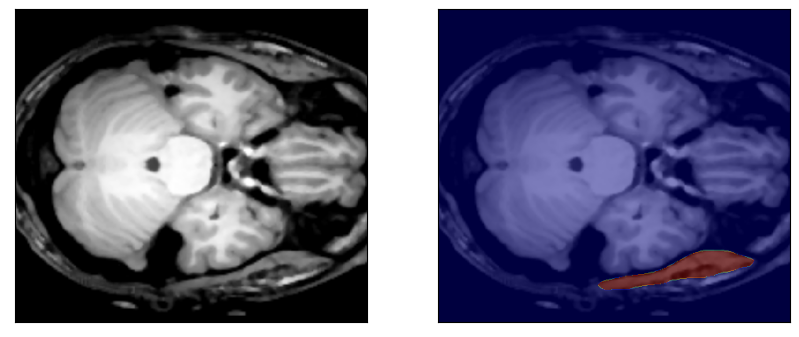

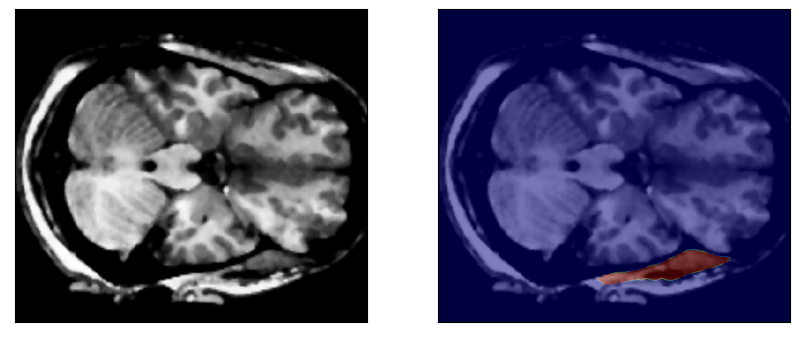

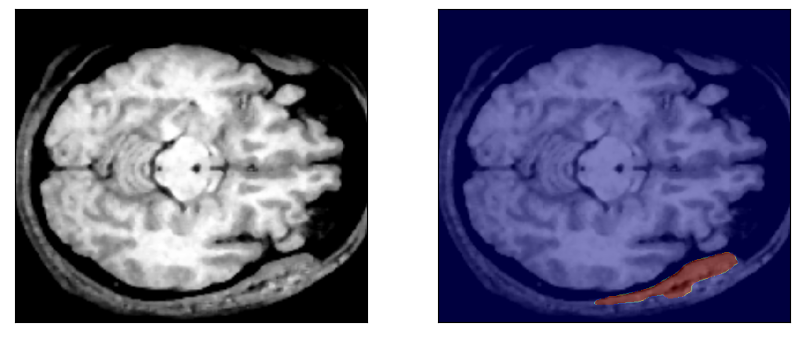

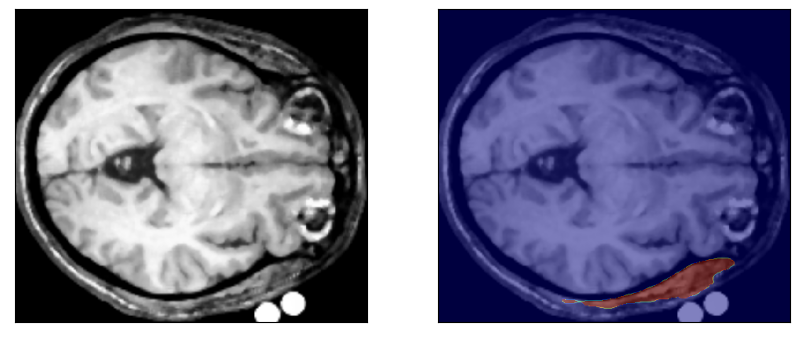

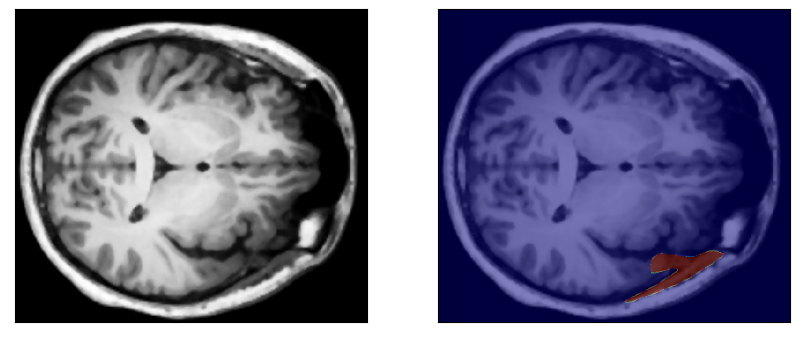

In [139]:
print("Anna accepted; Ben not accepted", len(df[(df['QA_to_bin_x']==1) & (df['QA_to_bin_y']==0)]['Segmentation']))

i=0
for i in range(0,len(df[(df['QA_to_bin_x']==1) & (df['QA_to_bin_y']==0)]['Segmentation'])):
    pic_path = df[(df['QA_to_bin_x']==1) & (df['QA_to_bin_y']==0)]['Segmentation'].iloc[i]
    pic_path_2 = df[(df['QA_to_bin_x']==1) & (df['QA_to_bin_y']==0)]['Raw_path_x'].iloc[i]


    img1 = Image.open(pic_path) 
    img1 = img1.crop((550, 100, 1000, 500))

    img2 = Image.open(pic_path_2) 
    img2 = img2.crop((550, 100, 1000, 500))


    f, axarr = plt.subplots(1,2, figsize=(10, 5))
    axarr[0].imshow(img2)
    axarr[1].imshow(img1)


    plt.setp(plt.gcf().get_axes(), xticks=[], yticks=[]);
    plt.show()

Anna not accepted; Ben accepted 176


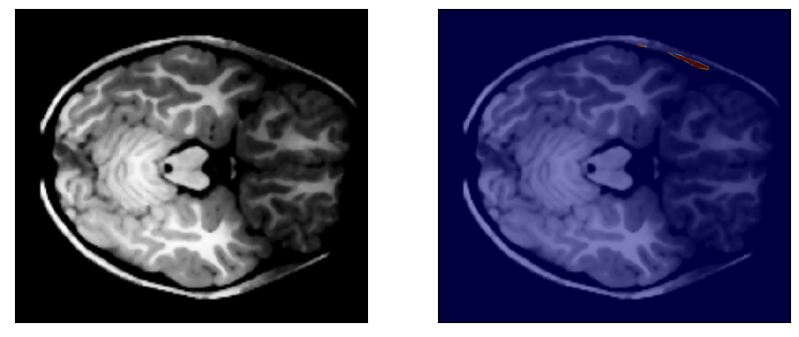

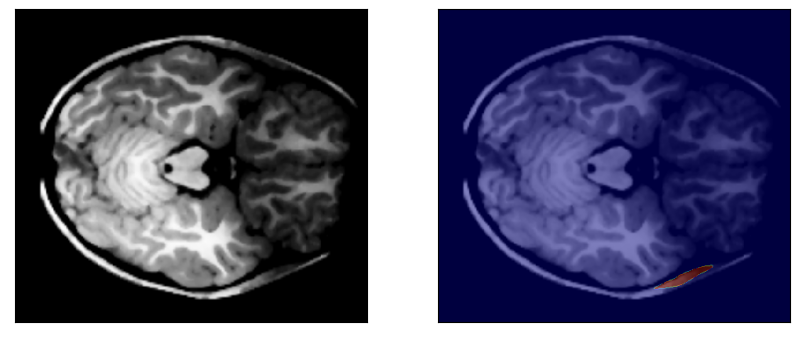

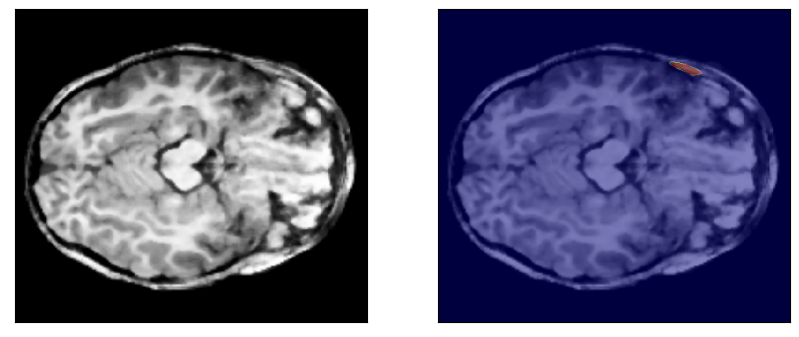

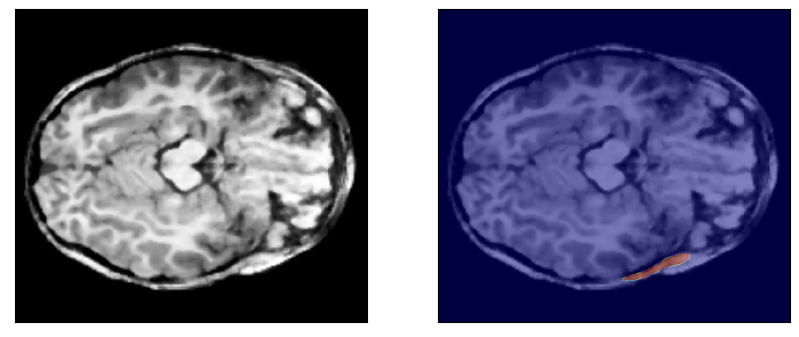

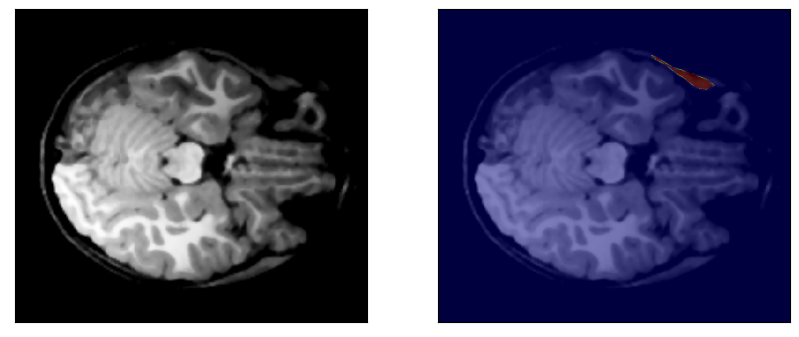

...

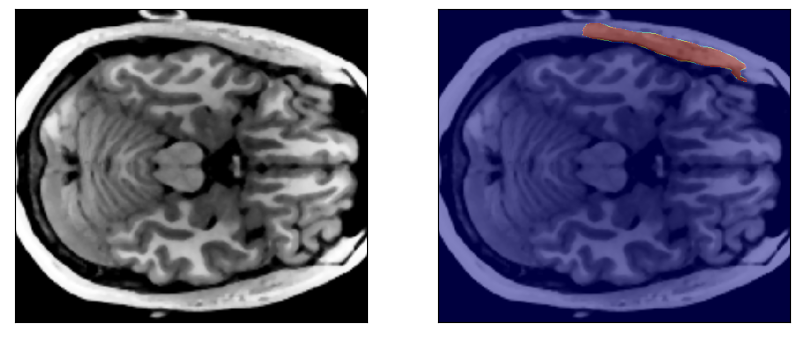

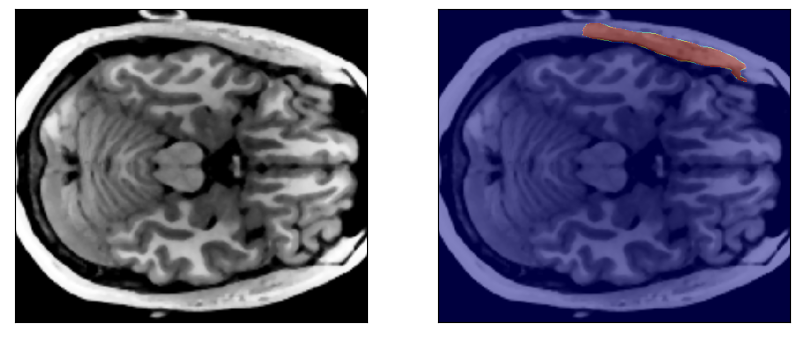

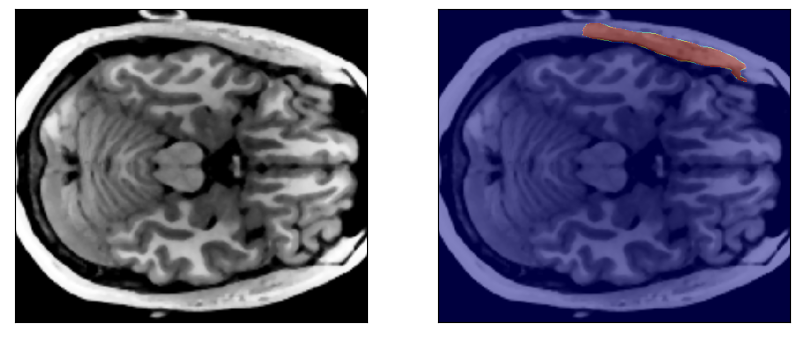

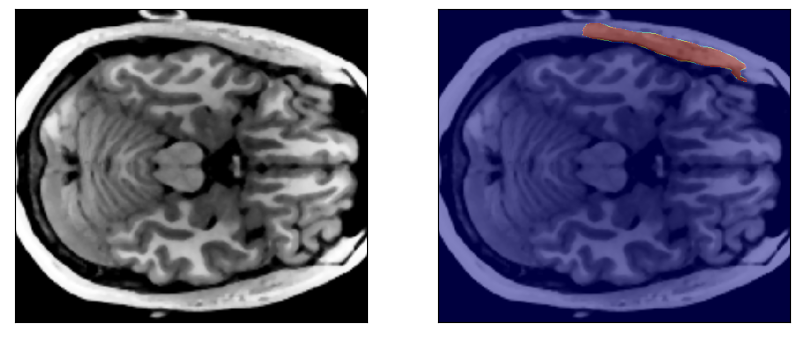

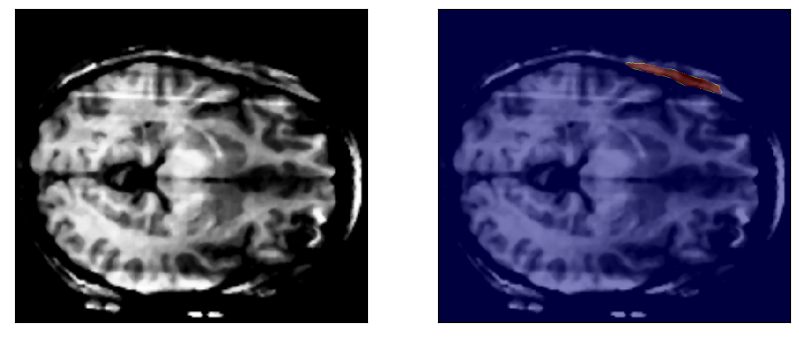

In [140]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

from PIL import Image 


print("Anna not accepted; Ben accepted",len(df[(df['QA_to_bin_x']==0) & (df['QA_to_bin_y']==1)]['Segmentation']))

i=0
for i in range(0,len(df[(df['QA_to_bin_x']==0) & (df['QA_to_bin_y']==1)]['Segmentation'])):
    pic_path = df[(df['QA_to_bin_x']==0) & (df['QA_to_bin_y']==1)]['Segmentation'].iloc[i]
    pic_path_2 = df[(df['QA_to_bin_x']==0) & (df['QA_to_bin_y']==1)]['Raw_path_x'].iloc[i]


    img1 = Image.open(pic_path) 
    img1 = img1.crop((550, 100, 1000, 500))

    img2 = Image.open(pic_path_2) 
    img2 = img2.crop((550, 100, 1000, 500))


    f, axarr = plt.subplots(1,2, figsize=(10, 5))
    axarr[0].imshow(img2)
    axarr[1].imshow(img1)


    plt.setp(plt.gcf().get_axes(), xticks=[], yticks=[]);
    plt.show()

In [184]:
import numpy as np
import scipy.misc
import sys, ast
def agreement(mat):
    """agreement(mat)
    Compute the percent agreement of a list of documents rated by a possibly different number of raters.
    Arguments:
        mat: a list of document ratings. It is a list of lists, where the inner list is a set of ratings.
    Returns:
        The percent agreement of the set of documents.
    Example:
        For two documents with three ratings for the first document and 4 ratings for the second document:
            $ mat = [[1,1,2],[4,4,4,3]]
            $ agreement(mat)
    """
    return  np.mean([scipy.misc.comb(np.unique(x,return_counts=True)[1],2).sum()/scipy.misc.comb(len(x),2) for x in mat])
    


In [ ]:
agreement([])